# Telco Customer Churn

### Focused customer retention programs

## Survival Analysis

## Information:

This project is from kaggle 

The project consist of predicting behavior to retain customers. We analyze all relevant customer data and develop focused customer retention programs.

## Data content

The data set includes information about:

Customers who left within the last month – the column is called Churn
Services that each customer has signed up for – phone, multiple lines, internet, online security, online backup, device protection, tech support, and streaming TV and movies
Customer account information – how long they’ve been a customer, contract, payment method, paperless billing, monthly charges, and total charges
Demographic info about customers – gender, age range, and if they have partners and dependents

## Importing libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from lifelines import KaplanMeierFitter, CoxPHFitter
from lifelines.utils import median_survival_times
from sklearn.model_selection import train_test_split

In [2]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 500)

# Exploratory Data Analysis (EDA)

In [3]:
df = pd.read_csv('WA_Fn-UseC_-Telco-Customer-Churn.csv')
df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   gender            7043 non-null   object 
 2   SeniorCitizen     7043 non-null   int64  
 3   Partner           7043 non-null   object 
 4   Dependents        7043 non-null   object 
 5   tenure            7043 non-null   int64  
 6   PhoneService      7043 non-null   object 
 7   MultipleLines     7043 non-null   object 
 8   InternetService   7043 non-null   object 
 9   OnlineSecurity    7043 non-null   object 
 10  OnlineBackup      7043 non-null   object 
 11  DeviceProtection  7043 non-null   object 
 12  TechSupport       7043 non-null   object 
 13  StreamingTV       7043 non-null   object 
 14  StreamingMovies   7043 non-null   object 
 15  Contract          7043 non-null   object 
 16  PaperlessBilling  7043 non-null   object 


In [5]:
# Checking total number of null values per features
df.isnull().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

In [6]:
df.shape

(7043, 21)

In [7]:
# More info about the data
df.describe()

,SeniorCitizen,tenure,MonthlyCharges
count,7043.000000,7043.000000,7043.000000
mean,0.162147,32.371149,64.761692
std,0.368612,24.559481,30.090047
min,0.000000,0.000000,18.250000
25%,0.000000,9.000000,35.500000
50%,0.000000,29.000000,70.350000
75%,0.000000,55.000000,89.850000
max,1.000000,72.000000,118.750000


## Data Visualization

Text(0.5, 1.0, 'Gender distribution among customer')

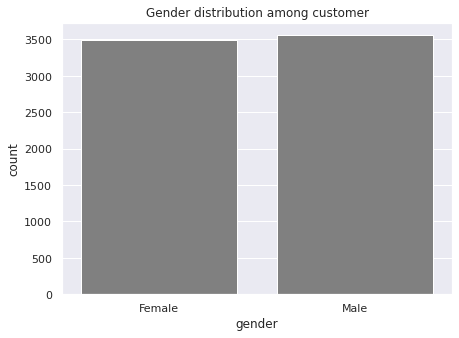

In [8]:
# Gender distribution amon customer

sns.set(style='darkgrid')
sns.set(rc={'figure.figsize':(7,5)})

sns.countplot(data=df,  x= 'gender', color='gray').set_title('Gender distribution among customer')

Text(0.5, 1.0, 'Senior citizens distribution grouped by partners')

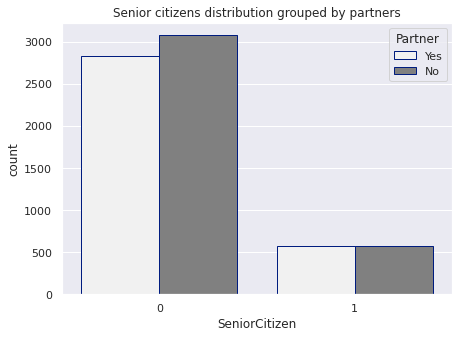

In [9]:
# Senior citizens distribution grouped by partners

sns.countplot(data=df,  x= 'SeniorCitizen', hue='Partner', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Senior citizens distribution grouped by partners')

Text(0.5, 1.0, 'Customers with Dependents')

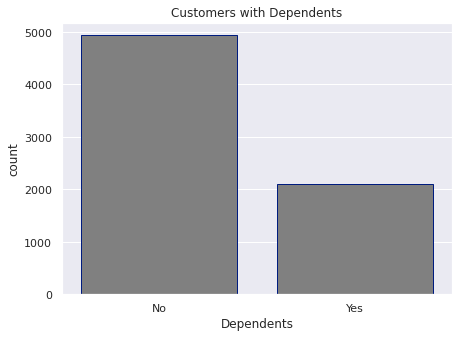

In [10]:
sns.countplot(data=df,  x= 'Dependents', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Customers with Dependents')

Text(0.5, 1.0, 'Dependent and partener distribution among customers')

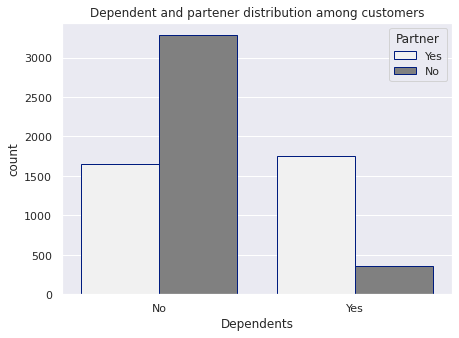

In [11]:
sns.countplot(data=df,  x= 'Dependents', hue='Partner', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Dependent and partener distribution among customers')

Text(0.5, 1.0, 'Dependent and Senior citizens distribution among customers')

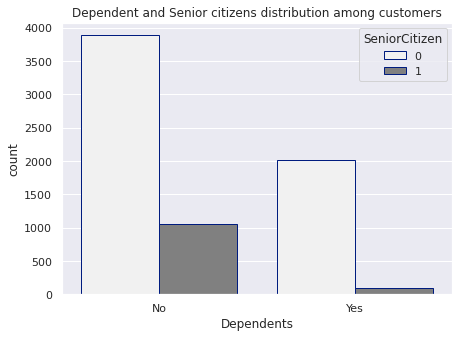

In [12]:
sns.countplot(data=df,  x= 'Dependents', hue='SeniorCitizen', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Dependent and Senior citizens distribution among customers')

Text(0.5, 1.0, 'Customers with phone services')

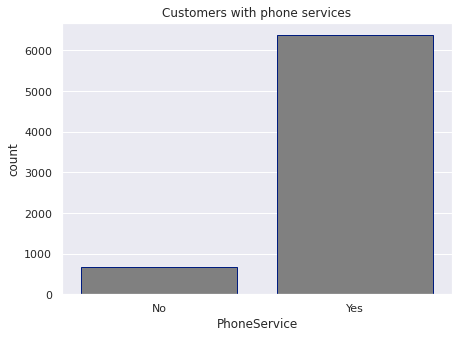

In [13]:
sns.countplot(data=df,  x= 'PhoneService', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Customers with phone services')

Text(0.5, 1.0, 'Customers with mulitiple line phone services grouped by gender')

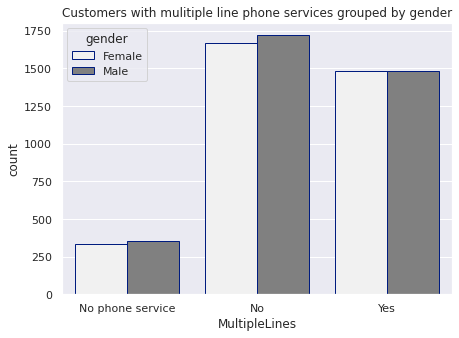

In [14]:
sns.countplot(data=df,  x= 'MultipleLines', hue='gender', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Customers with mulitiple line phone services grouped by gender')

Text(0.5, 1.0, 'Customers with mulitiple line phone services')

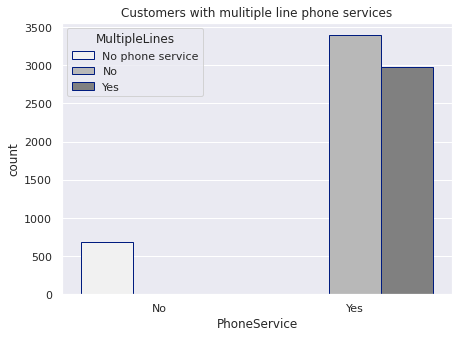

In [15]:
sns.countplot(data=df,  x= 'PhoneService', hue='MultipleLines', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Customers with mulitiple line phone services')

Text(0.5, 1.0, 'Customers with internet services')

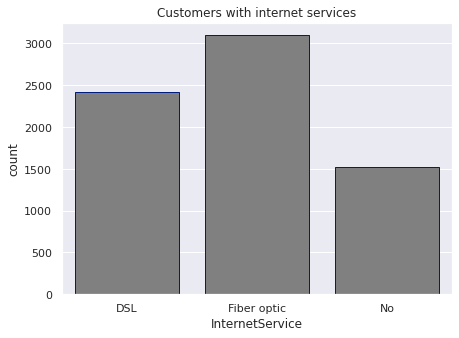

In [16]:
sns.countplot(data=df,  x= 'InternetService', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Customers with internet services')

Text(0.5, 1.0, 'Online Security')

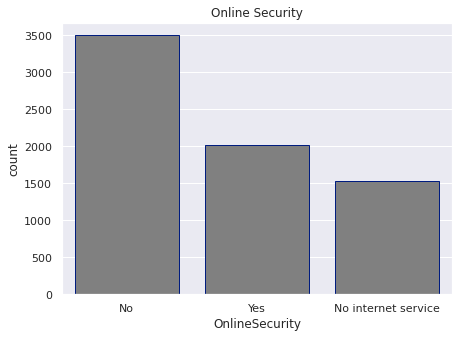

In [17]:
sns.countplot(data=df,  x= 'OnlineSecurity', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Online Security')

Text(0.5, 1.0, 'Internet Service and Online Security')

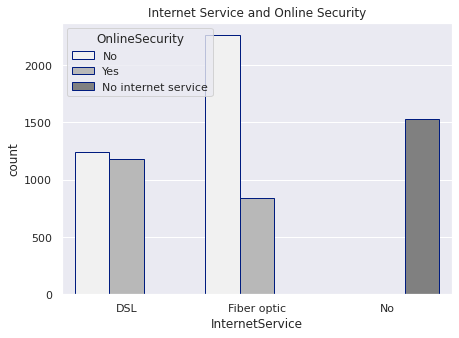

In [18]:
sns.countplot(data=df,  x= 'InternetService', hue='OnlineSecurity', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Internet Service and Online Security')

Text(0.5, 1.0, 'Internet Service and Online Backup')

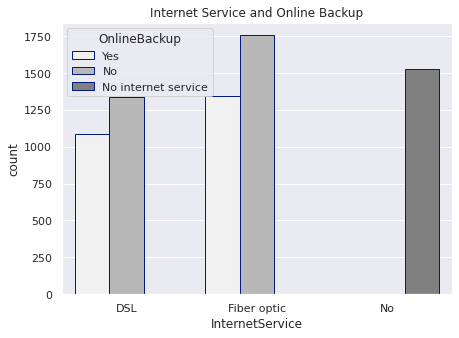

In [19]:
sns.countplot(data=df,  x= 'InternetService', hue='OnlineBackup', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Internet Service and Online Backup')

Text(0.5, 1.0, 'Internet Service and Device Protection')

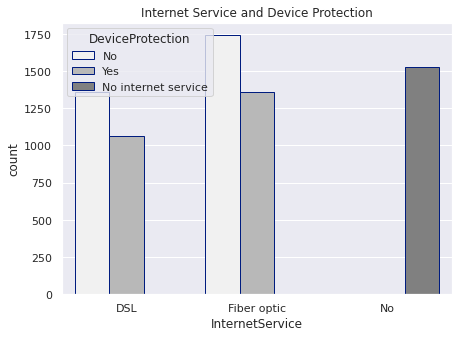

In [20]:
sns.countplot(data=df,  x= 'InternetService', hue='DeviceProtection', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Internet Service and Device Protection')

Text(0.5, 1.0, 'Internet Service and Tech Support')

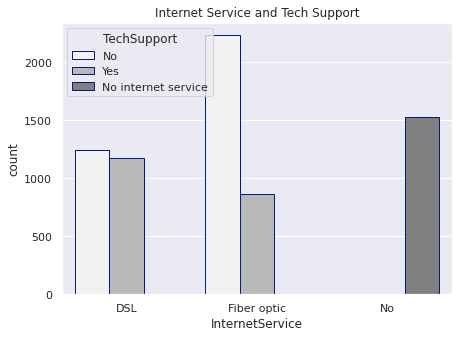

In [21]:
sns.countplot(data=df,  x= 'InternetService', hue='TechSupport', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Internet Service and Tech Support')

Text(0.5, 1.0, 'Internet Service and Streaming TV')

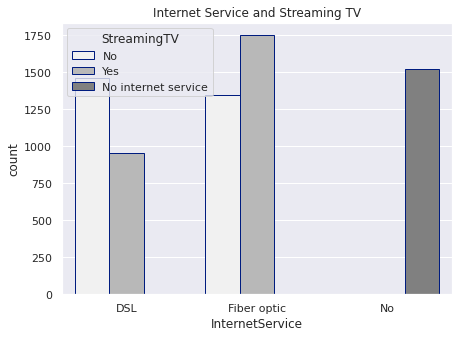

In [22]:
sns.countplot(data=df,  x= 'InternetService', hue='StreamingTV', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Internet Service and Streaming TV')

Text(0.5, 1.0, 'Internet Service and Streaming Movies')

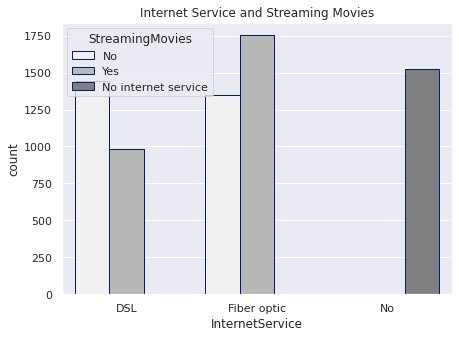

In [23]:
sns.countplot(data=df,  x= 'InternetService', hue='StreamingMovies', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Internet Service and Streaming Movies')

Text(0.5, 1.0, 'Types of contracts among the customers')

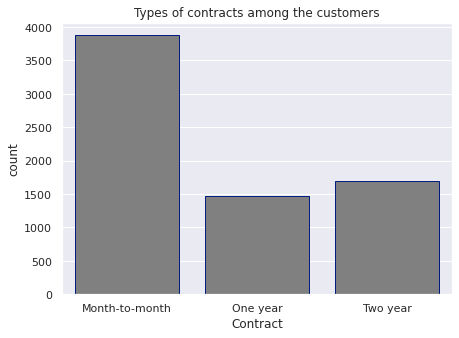

In [24]:
sns.countplot(data=df,  x= 'Contract', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Types of contracts among the customers')

Text(0.5, 1.0, 'Types of contracts and Paperless Billing')

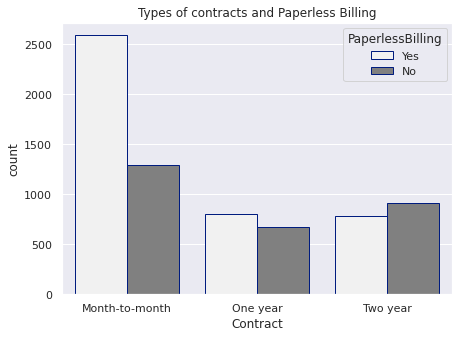

In [25]:
sns.countplot(data=df,  x= 'Contract', hue='PaperlessBilling', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Types of contracts and Paperless Billing')

Text(0.5, 1.0, 'Types of contracts and Payment Method')

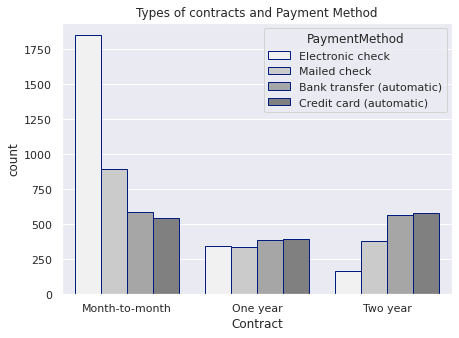

In [26]:
sns.countplot(data=df,  x= 'Contract', hue='PaymentMethod', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Types of contracts and Payment Method')

Text(0.5, 1.0, 'Churning Customers grouped by gender')

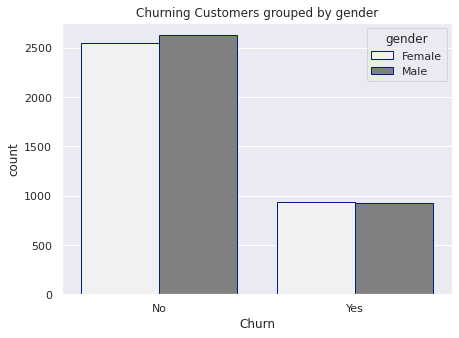

In [27]:
sns.countplot(data=df,  x= 'Churn', hue='gender', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by gender')

Text(0.5, 1.0, 'Churning Customers grouped by Senior or Normal Citizens')

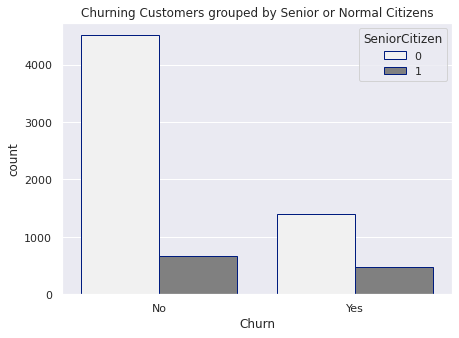

In [28]:
sns.countplot(data=df,  x= 'Churn', hue='SeniorCitizen', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Senior or Normal Citizens')

Text(0.5, 1.0, 'Churning Customers grouped by Customers with or without Patner')

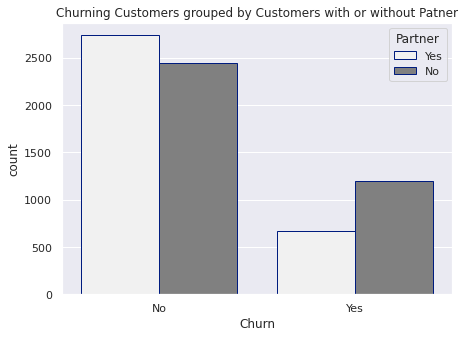

In [29]:
sns.countplot(data=df,  x= 'Churn', hue='Partner', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customers with or without Patner')

Text(0.5, 1.0, 'Churning Customers grouped by Dependents or No Dependents')

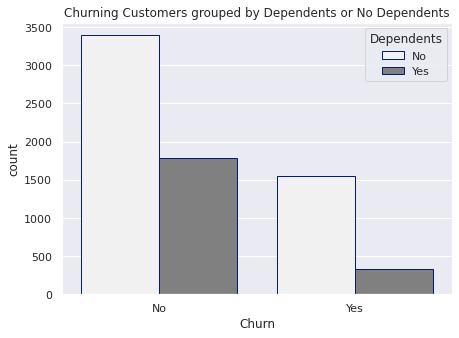

In [30]:
sns.countplot(data=df,  x= 'Churn', hue='Dependents', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Dependents or No Dependents')

Text(0.5, 1.0, 'Churning Customers grouped by Customer with or without Phone Service')

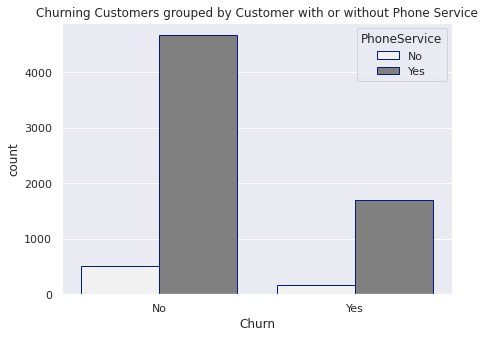

In [31]:
sns.countplot(data=df,  x= 'Churn', hue='PhoneService', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customer with or without Phone Service')

Text(0.5, 1.0, 'Churning Customers grouped by Customer with or without Multiple Lines')

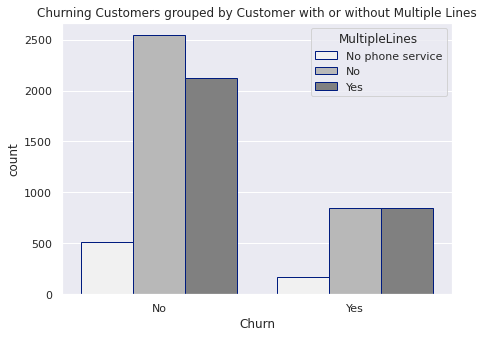

In [32]:
sns.countplot(data=df,  x= 'Churn', hue='MultipleLines', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customer with or without Multiple Lines')

Text(0.5, 1.0, 'Churning Customers grouped by Customer with or without Internet Service')

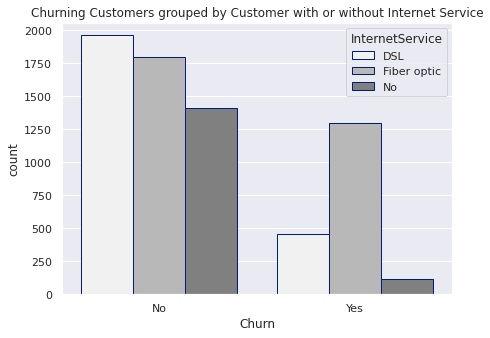

In [33]:
sns.countplot(data=df,  x= 'Churn', hue='InternetService', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customer with or without Internet Service')

Text(0.5, 1.0, 'Churning Customers grouped by Online Security')

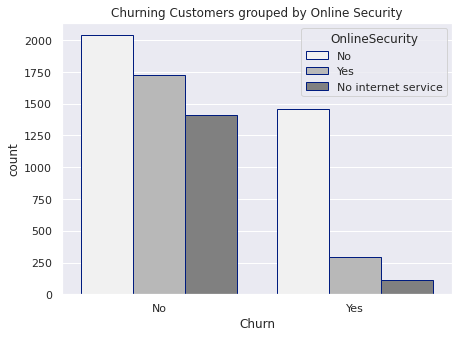

In [34]:
sns.countplot(data=df,  x= 'Churn', hue='OnlineSecurity', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Online Security')

Text(0.5, 1.0, 'Churning Customers grouped by Online Backup')

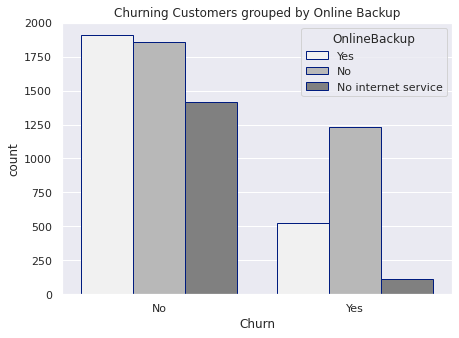

In [35]:
sns.countplot(data=df,  x= 'Churn', hue='OnlineBackup', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Online Backup')

Text(0.5, 1.0, 'Churning Customers grouped by Customer with or without Device Protection')

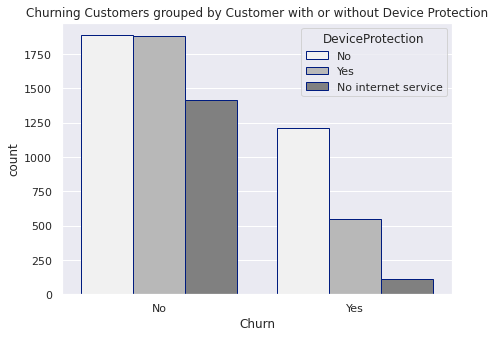

In [36]:
sns.countplot(data=df,  x= 'Churn', hue='DeviceProtection', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customer with or without Device Protection')

Text(0.5, 1.0, 'Churning Customers grouped by Customer with or without Tech Protection')

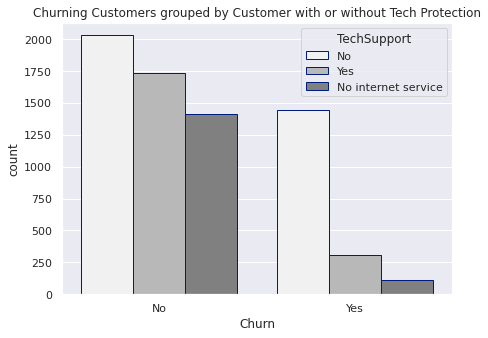

In [37]:
sns.countplot(data=df,  x= 'Churn', hue='TechSupport', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customer with or without Tech Protection')

Text(0.5, 1.0, 'Churning Customers grouped by Customer with or without StreamingTV')

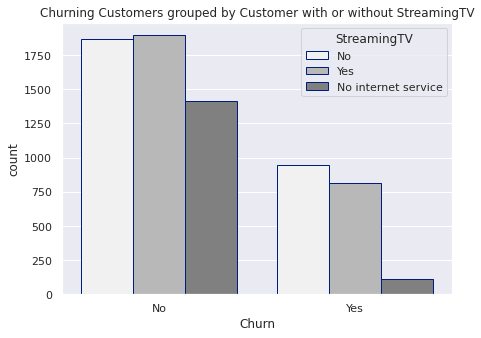

In [38]:
sns.countplot(data=df,  x= 'Churn', hue='StreamingTV', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customer with or without StreamingTV')

Text(0.5, 1.0, 'Churning Customers grouped by Customer with or without Streaming Movies')

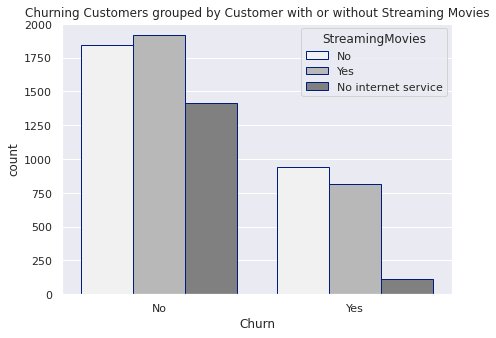

In [39]:
sns.countplot(data=df,  x= 'Churn', hue='StreamingMovies', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customer with or without Streaming Movies')

Text(0.5, 1.0, 'Churning Customers grouped by Contract')

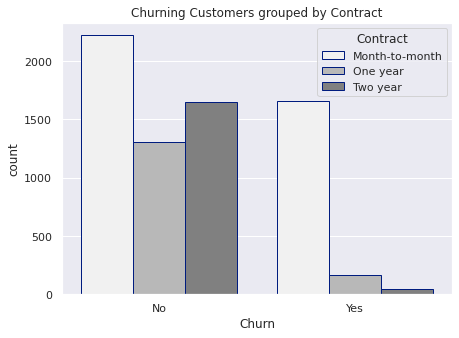

In [40]:
sns.countplot(data=df,  x= 'Churn', hue='Contract', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Contract')

Text(0.5, 1.0, 'Churning Customers grouped by Customer with or without paperless billing')

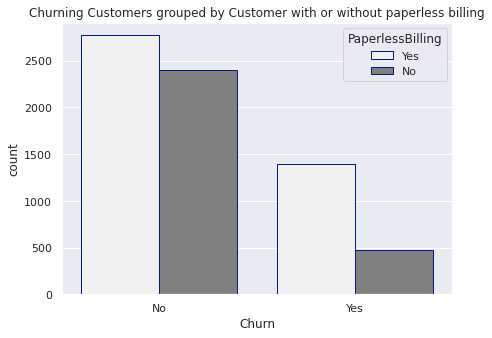

In [41]:
sns.countplot(data=df,  x= 'Churn', hue='PaperlessBilling', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Customer with or without paperless billing')

Text(0.5, 1.0, 'Churning Customers grouped by Payment Mehod')

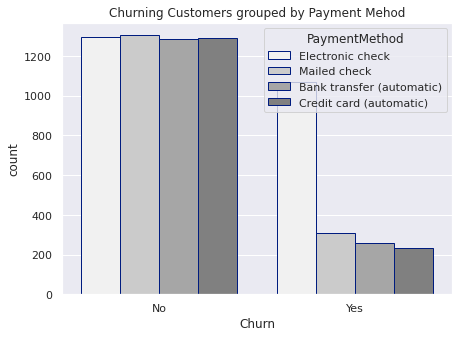

In [42]:
sns.countplot(data=df,  x= 'Churn', hue='PaymentMethod', color='gray', edgecolor=sns.color_palette('dark', 1)).set_title('Churning Customers grouped by Payment Mehod')

<AxesSubplot:>

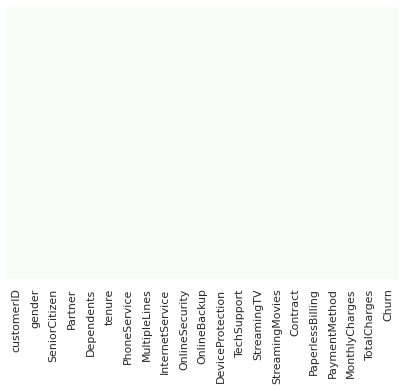

In [43]:
sns.heatmap(df.isnull(), yticklabels=False , cbar=False, cmap="Greens")

## Feature Engineering

In [44]:
df[['Churn', 'gender', 'customerID']].groupby(['gender', 'Churn']).count()

customerID
gender Churn            
Female No           2549
       Yes           939
Male   No           2625
       Yes           930

In [45]:
df[['Churn', 'SeniorCitizen', 'customerID']].groupby(['SeniorCitizen', 'Churn']).count()

customerID
SeniorCitizen Churn            
0             No           4508
              Yes          1393
1             No            666
              Yes           476

In [46]:
df[['gender', 'SeniorCitizen', 'Churn', 'customerID']].groupby(['gender', 'SeniorCitizen', 'Churn']).count()

customerID
gender SeniorCitizen Churn            
Female 0             No           2221
                     Yes           699
       1             No            328
                     Yes           240
Male   0             No           2287
                     Yes           694
       1             No            338
                     Yes           236

replacing gender (male and female with a values 0 and 1)

In [47]:
print(df.gender.value_counts())
df['Female'] = df['gender'] == 'Female'
df['Female'] = df['Female'].astype(int)
df.drop('gender', axis=1, inplace=True)

Male      3555
Female    3488
Name: gender, dtype: int64


In [48]:
# the new column has a 0 when the customer is a male and 1 otherwise
print(df.Female.value_counts())

0    3555
1    3488
Name: Female, dtype: int64


modify the partner column, set 1 if the customer has a partner and 0 otherwise

In [49]:
print(df.Partner.value_counts())
df['Partner'] = df['Partner'].map({'Yes':1, 'No':0})

No     3641
Yes    3402
Name: Partner, dtype: int64


In [50]:
print(df.Partner.value_counts())

0    3641
1    3402
Name: Partner, dtype: int64


In [51]:
df.SeniorCitizen.value_counts()

0    5901
1    1142
Name: SeniorCitizen, dtype: int64

modify the Dependents column, set 1 if the customer has Dependents and 0 otherwise

In [52]:
print(df.Dependents.value_counts())
df['Dependents'] = df['Dependents'].map({'Yes':1, 'No':0})

No     4933
Yes    2110
Name: Dependents, dtype: int64


In [53]:
print(df.Dependents.value_counts())

0    4933
1    2110
Name: Dependents, dtype: int64


modify the PhoneService column, set 1 if the customer has a PhoneService and 0 otherwise

In [54]:
print(df.PhoneService.value_counts())
df['PhoneService'] = df['PhoneService'].map({'Yes':1, 'No':0})

Yes    6361
No      682
Name: PhoneService, dtype: int64


In [55]:
print(df.PhoneService.value_counts())

1    6361
0     682
Name: PhoneService, dtype: int64


modify the Multiple lines column, set 1 if the customer has a subscribe to Multiple lines and 0 otherwise

In [56]:
print(df.MultipleLines.value_counts())
df['MultipleLines'] = df['MultipleLines'].map({'Yes':1, 'No':0, 'No phone service':0})

No                  3390
Yes                 2971
No phone service     682
Name: MultipleLines, dtype: int64


In [57]:
print(df.MultipleLines.value_counts())

0    4072
1    2971
Name: MultipleLines, dtype: int64


Internet service 

In [58]:
print(df.InternetService.value_counts()) # will one hot encode below

Fiber optic    3096
DSL            2421
No             1526
Name: InternetService, dtype: int64


modify the Online security column, set 1 if the customer has a Online security and 0 otherwise

In [59]:
print(df.OnlineSecurity.value_counts())
df['OnlineSecurity'] = df['OnlineSecurity'].map({'Yes':1, 'No':0, 'No internet service':0})

No                     3498
Yes                    2019
No internet service    1526
Name: OnlineSecurity, dtype: int64


In [60]:
print(df.OnlineSecurity.value_counts())

0    5024
1    2019
Name: OnlineSecurity, dtype: int64


Online Back up column

In [61]:
print(df.OnlineBackup.value_counts())
df['OnlineBackup'] = df['OnlineBackup'].map({'Yes':1, 'No':0, 'No internet service':0})

No                     3088
Yes                    2429
No internet service    1526
Name: OnlineBackup, dtype: int64


In [62]:
print(df.OnlineBackup.value_counts())

0    4614
1    2429
Name: OnlineBackup, dtype: int64


Device Protection column

In [63]:
print(df.DeviceProtection.value_counts())
df['DeviceProtection'] = df['DeviceProtection'].map({'Yes':1, 'No':0, 'No internet service':0})

No                     3095
Yes                    2422
No internet service    1526
Name: DeviceProtection, dtype: int64


In [64]:
print(df.DeviceProtection.value_counts())

0    4621
1    2422
Name: DeviceProtection, dtype: int64


Tech support column

In [65]:
print(df.TechSupport.value_counts())
df['TechSupport'] = df['TechSupport'].map({'Yes':1, 'No':0, 'No internet service':0})

No                     3473
Yes                    2044
No internet service    1526
Name: TechSupport, dtype: int64


In [66]:
print(df.TechSupport.value_counts())

0    4999
1    2044
Name: TechSupport, dtype: int64


Sreaming TV column

In [67]:
print(df.StreamingTV.value_counts())
df['StreamingTV'] = df['StreamingTV'].map({'Yes':1, 'No':0, 'No internet service':0})

No                     2810
Yes                    2707
No internet service    1526
Name: StreamingTV, dtype: int64


In [68]:
print(df.StreamingTV.value_counts())

0    4336
1    2707
Name: StreamingTV, dtype: int64


Sreaming Movies column

In [69]:
print(df.StreamingMovies.value_counts())
df['StreamingMovies'] = df['StreamingMovies'].map({'Yes':1, 'No':0, 'No internet service':0})

No                     2785
Yes                    2732
No internet service    1526
Name: StreamingMovies, dtype: int64


In [70]:
print(df.StreamingMovies.value_counts())

0    4311
1    2732
Name: StreamingMovies, dtype: int64


Contract column

In [71]:
df.Contract.value_counts() # will one hot encode below

Month-to-month    3875
Two year          1695
One year          1473
Name: Contract, dtype: int64

Paperless Billing column

In [72]:
print(df.PaperlessBilling.value_counts())
df['PaperlessBilling'] = df['PaperlessBilling'].map({'Yes':1, 'No':0})

Yes    4171
No     2872
Name: PaperlessBilling, dtype: int64


In [73]:
df.PaperlessBilling.value_counts()

1    4171
0    2872
Name: PaperlessBilling, dtype: int64

Papyment method column

In [74]:
df.PaymentMethod.value_counts() # will one hot encode below

Electronic check             2365
Mailed check                 1612
Bank transfer (automatic)    1544
Credit card (automatic)      1522
Name: PaymentMethod, dtype: int64

Churn Column

In [75]:
print(df.Churn.value_counts())
df['Churn'] = df['Churn'].map({'Yes':1, 'No':0})

No     5174
Yes    1869
Name: Churn, dtype: int64


In [76]:
df.Churn.value_counts()

0    5174
1    1869
Name: Churn, dtype: int64

Total charges column

In [77]:
df['TotalCharges'] = df['TotalCharges'].replace(" ", np.nan).astype(float)
df['TotalCharges'].fillna(df['TotalCharges'].mean(), inplace = True)

In [78]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   SeniorCitizen     7043 non-null   int64  
 2   Partner           7043 non-null   int64  
 3   Dependents        7043 non-null   int64  
 4   tenure            7043 non-null   int64  
 5   PhoneService      7043 non-null   int64  
 6   MultipleLines     7043 non-null   int64  
 7   InternetService   7043 non-null   object 
 8   OnlineSecurity    7043 non-null   int64  
 9   OnlineBackup      7043 non-null   int64  
 10  DeviceProtection  7043 non-null   int64  
 11  TechSupport       7043 non-null   int64  
 12  StreamingTV       7043 non-null   int64  
 13  StreamingMovies   7043 non-null   int64  
 14  Contract          7043 non-null   object 
 15  PaperlessBilling  7043 non-null   int64  
 16  PaymentMethod     7043 non-null   object 


In [79]:
df.head()

,customerID,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Female
0,7590-VHVEG,0,1,0,1,0,0,DSL,0,1,0,0,0,0,Month-to-month,1,Electronic check,29.85,29.85,0,1
1,5575-GNVDE,0,0,0,34,1,0,DSL,1,0,1,0,0,0,One year,0,Mailed check,56.95,1889.50,0,0
2,3668-QPYBK,0,0,0,2,1,0,DSL,1,1,0,0,0,0,Month-to-month,1,Mailed check,53.85,108.15,1,0
3,7795-CFOCW,0,0,0,45,0,0,DSL,1,0,1,1,0,0,One year,0,Bank transfer (automatic),42.30,1840.75,0,0
4,9237-HQITU,0,0,0,2,1,0,Fiber optic,0,0,0,0,0,0,Month-to-month,1,Electronic check,70.70,151.65,1,1


# Model Building

## Training Multiple Kaplan Meier Fitter Models

In [80]:
T = df['tenure']
E = df['Churn']

In [81]:
kmf = KaplanMeierFitter()
kmf.fit(T, event_observed=E)

<lifelines.KaplanMeierFitter:"KM_estimate", fitted with 7043 total observations, 5174 right-censored observations>

<AxesSubplot:xlabel='timeline'>

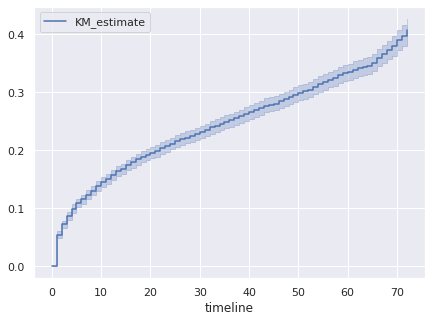

In [82]:
kmf.plot_cumulative_density()

<AxesSubplot:xlabel='timeline'>

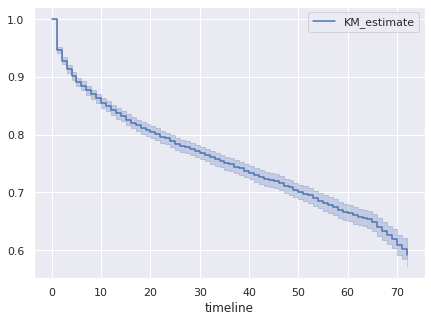

In [83]:
kmf.plot_survival_function()

In [84]:
median_ = kmf.median_survival_time_
print('Median value: ' + str(median_))

Median value: inf


### Survival Analysis of churning Customer Groups ( Senior Citizens Vs. Normal Citizens)

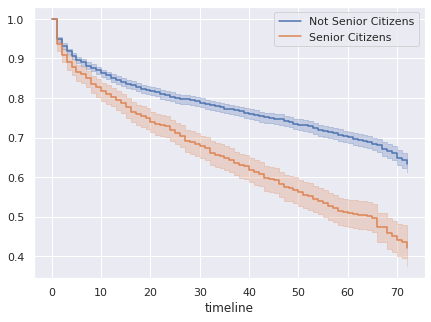

In [85]:
seniorCitizen = (df['SeniorCitizen'] == 1)

kmf.fit(T[~seniorCitizen], E[~seniorCitizen], label='Not Senior Citizens')
ax = kmf.plot()

kmf.fit(T[seniorCitizen], E[seniorCitizen], label='Senior Citizens')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Partner Vs. Without Partner)

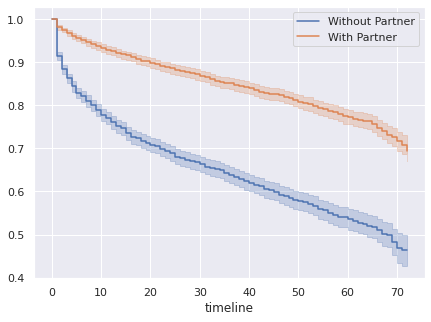

In [86]:
Partner = (df['Partner'] == 1)

kmf.fit(T[~Partner], E[~Partner], label='Without Partner')
ax = kmf.plot()

kmf.fit(T[Partner], E[Partner], label='With Partner')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Dependents Vs. Without Dependents)

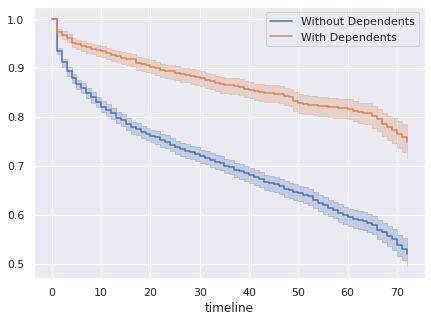

In [87]:
Dependents = (df['Dependents'] == 1)

kmf.fit(T[~Dependents], E[~Dependents], label='Without Dependents')
ax = kmf.plot()

kmf.fit(T[Dependents], E[Dependents], label='With Dependents')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With PhoneService Vs. Without PhoneService)

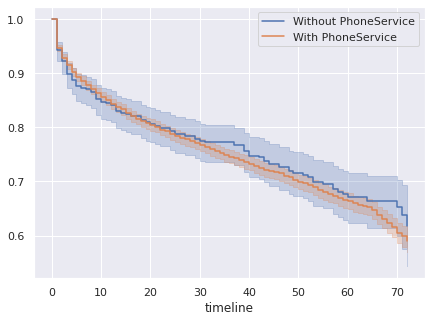

In [88]:
PhoneService = (df['PhoneService'] == 1)

kmf.fit(T[~PhoneService], E[~PhoneService], label='Without PhoneService')
ax = kmf.plot()

kmf.fit(T[PhoneService], E[PhoneService], label='With PhoneService')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With MultipleLines Vs. Without MultipleLines)

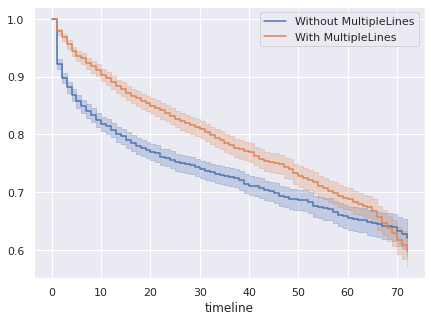

In [89]:
MultipleLines = (df['MultipleLines'] == 1)

kmf.fit(T[~MultipleLines], E[~MultipleLines], label='Without MultipleLines')
ax = kmf.plot()

kmf.fit(T[MultipleLines], E[MultipleLines], label='With MultipleLines')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With DSL Vs. With Fiber Optics Vs. No Internet service)

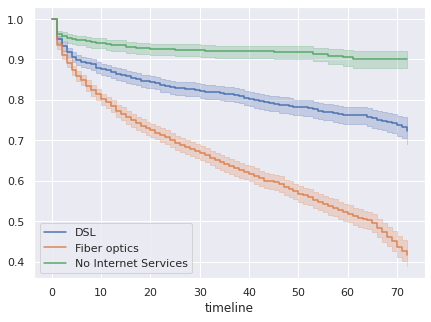

In [90]:
InternetServiceDSL = (df['InternetService'] == 'DSL')
InternetServiceFiberOptic = (df['InternetService'] == 'Fiber optic')
NoInternetService = (df['InternetService'] == 'No')

kmf.fit(T[InternetServiceDSL], E[InternetServiceDSL], label='DSL')
ax = kmf.plot()

kmf.fit(T[InternetServiceFiberOptic], E[InternetServiceFiberOptic], label='Fiber optics')
ax = kmf.plot(ax=ax)

kmf.fit(T[NoInternetService], E[NoInternetService], label='No Internet Services')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Online security Vs. Without Online security)

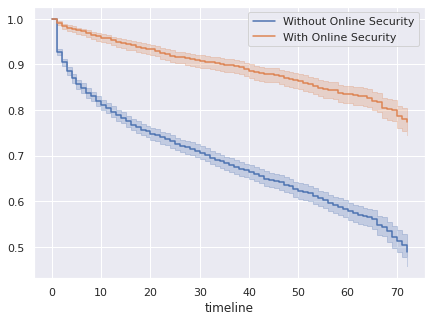

In [91]:
OnlineSecurity = (df['OnlineSecurity'] == 1)

kmf.fit(T[~OnlineSecurity], E[~OnlineSecurity], label='Without Online Security')
ax = kmf.plot()

kmf.fit(T[OnlineSecurity], E[OnlineSecurity], label='With Online Security')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Online Back up Vs. Without Online Back up)

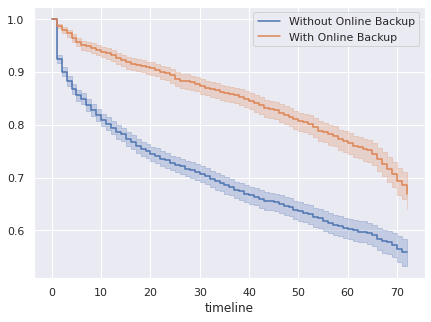

In [92]:
OnlineBackup = (df['OnlineBackup'] == 1)

kmf.fit(T[~OnlineBackup], E[~OnlineBackup], label='Without Online Backup')
ax = kmf.plot()

kmf.fit(T[OnlineBackup], E[OnlineBackup], label='With Online Backup')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Device Protection Vs. Without Device protection)

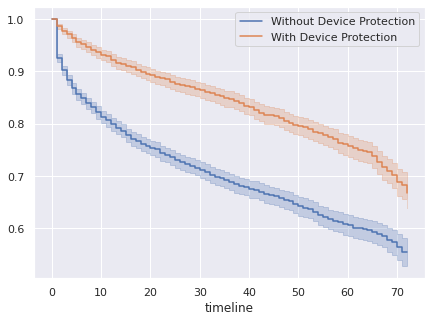

In [93]:
DeviceProtection = (df['DeviceProtection'] == 1)

kmf.fit(T[~DeviceProtection], E[~DeviceProtection], label='Without Device Protection')
ax = kmf.plot()

kmf.fit(T[DeviceProtection], E[DeviceProtection], label='With Device Protection')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Tech Support Vs. Without tech support)

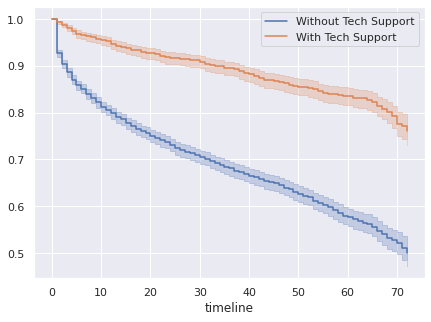

In [94]:
TechSupport = (df['TechSupport'] == 1)

kmf.fit(T[~TechSupport], E[~TechSupport], label='Without Tech Support')
ax = kmf.plot()

kmf.fit(T[TechSupport], E[TechSupport], label='With Tech Support')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Streaming TV Vs. Without Streaming TV)

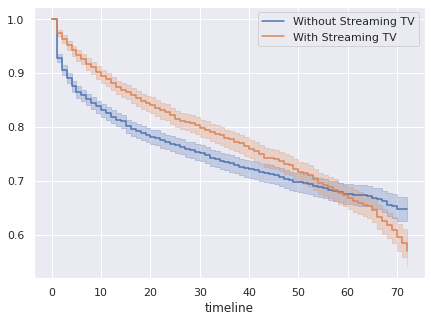

In [95]:
StreamingTV = (df['StreamingTV'] == 1)

kmf.fit(T[~StreamingTV], E[~StreamingTV], label='Without Streaming TV')
ax = kmf.plot()

kmf.fit(T[StreamingTV], E[StreamingTV], label='With Streaming TV')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Streaming Movies Vs. Without Streaming Movies)

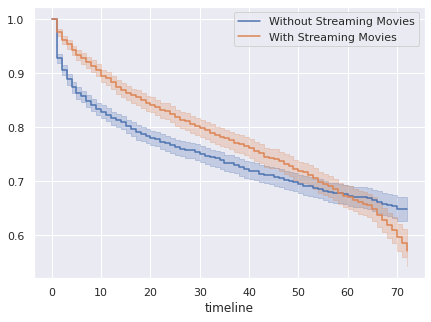

In [96]:
StreamingMovies = (df['StreamingMovies'] == 1)

kmf.fit(T[~StreamingMovies], E[~StreamingMovies], label='Without Streaming Movies')
ax = kmf.plot()

kmf.fit(T[StreamingMovies], E[StreamingMovies], label='With Streaming Movies')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( With Paperless Billing Vs. Without Paperless Billing)

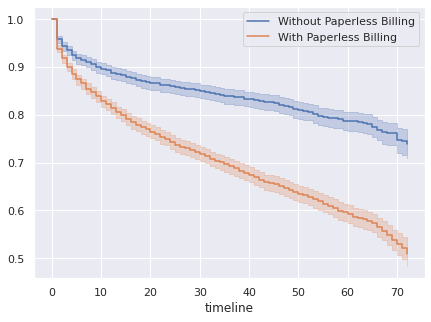

In [97]:
PaperlessBilling = (df['PaperlessBilling'] == 1)

kmf.fit(T[~PaperlessBilling], E[~PaperlessBilling], label='Without Paperless Billing')
ax = kmf.plot()

kmf.fit(T[PaperlessBilling], E[PaperlessBilling], label='With Paperless Billing')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( Electronic Check Vs. Mailed Checked Vs. Bank Transfer Vs. Credit Card)

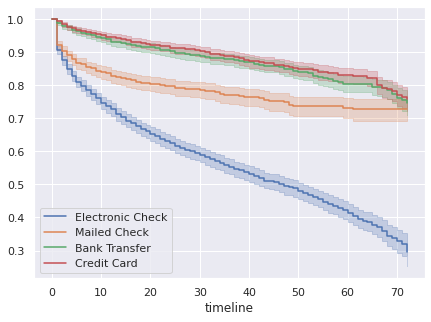

In [98]:
ElectronicCheck = (df['PaymentMethod'] == 'Electronic check')
MailedCheck = (df['PaymentMethod'] == 'Mailed check')
BankTransfer = (df['PaymentMethod'] == 'Bank transfer (automatic)')
CreditCard = (df['PaymentMethod'] == 'Credit card (automatic)')

kmf.fit(T[ElectronicCheck], E[ElectronicCheck], label='Electronic Check')
ax = kmf.plot()

kmf.fit(T[MailedCheck], E[MailedCheck], label='Mailed Check')
ax = kmf.plot(ax=ax)

kmf.fit(T[BankTransfer], E[BankTransfer], label='Bank Transfer')
ax = kmf.plot(ax=ax)

kmf.fit(T[CreditCard], E[CreditCard], label='Credit Card')
ax = kmf.plot(ax=ax)

### Survival Analysis of churning Customer Groups ( Male Vs. Female)

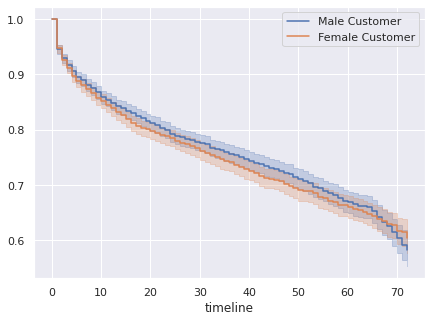

In [99]:
Female = (df['Female'] == 1)

kmf.fit(T[~Female], E[~Female], label='Male Customer')
ax = kmf.plot()

kmf.fit(T[Female], E[Female], label='Female Customer') 
ax = kmf.plot(ax=ax)

In [100]:
df.columns

Index(['customerID', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn', 'Female'], dtype='object')

## Training a Cox Proportional Hazard Regression Model

In [101]:
cols_of_interest = ['SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn', 'Female']

data = df[cols_of_interest]
data.head()

,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Female
0,0,1,0,1,0,0,DSL,0,1,0,0,0,0,Month-to-month,1,Electronic check,29.85,29.85,0,1
1,0,0,0,34,1,0,DSL,1,0,1,0,0,0,One year,0,Mailed check,56.95,1889.50,0,0
2,0,0,0,2,1,0,DSL,1,1,0,0,0,0,Month-to-month,1,Mailed check,53.85,108.15,1,0
3,0,0,0,45,0,0,DSL,1,0,1,1,0,0,One year,0,Bank transfer (automatic),42.30,1840.75,0,0
4,0,0,0,2,1,0,Fiber optic,0,0,0,0,0,0,Month-to-month,1,Electronic check,70.70,151.65,1,1


In [102]:
data.shape

(7043, 20)

dropping the following columns to avoid matrix singularity error during model training

those columns weren't one hot encoded in the feature engineering section, as they  were neede for modeling

In [103]:
data = pd.get_dummies(data)
data.drop('Contract_Two year', axis=1, inplace=True)
data.drop('PaymentMethod_Mailed check', axis=1, inplace=True)
data.drop('InternetService_Fiber optic', axis=1, inplace=True)
data.head()

,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,Female,InternetService_DSL,InternetService_No,Contract_Month-to-month,Contract_One year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check
0,0,1,0,1,0,0,0,1,0,0,0,0,1,29.85,29.85,0,1,1,0,1,0,0,0,1
1,0,0,0,34,1,0,1,0,1,0,0,0,0,56.95,1889.50,0,0,1,0,0,1,0,0,0
2,0,0,0,2,1,0,1,1,0,0,0,0,1,53.85,108.15,1,0,1,0,1,0,0,0,0
3,0,0,0,45,0,0,1,0,1,1,0,0,0,42.30,1840.75,0,0,1,0,0,1,1,0,0
4,0,0,0,2,1,0,0,0,0,0,0,0,1,70.70,151.65,1,1,0,0,1,0,0,0,1


In [104]:
data.shape

(7043, 24)

In [106]:
cph = CoxPHFitter()
cph.fit(data, 'tenure', event_col='Churn', show_progress=True)

Iteration 1: norm_delta = 2.42809, step_size = 0.9000, log_lik = -15653.03964, newton_decrement = 2319.28370, seconds_since_start = 0.0
Iteration 2: norm_delta = 1.75180, step_size = 0.9000, log_lik = -13373.09236, newton_decrement = 474.28171, seconds_since_start = 0.0
Iteration 3: norm_delta = 1.19590, step_size = 0.9000, log_lik = -12839.05175, newton_decrement = 137.54091, seconds_since_start = 0.0
Iteration 4: norm_delta = 0.53579, step_size = 1.0000, log_lik = -12677.08477, newton_decrement = 15.87658, seconds_since_start = 0.1
Iteration 5: norm_delta = 0.08528, step_size = 1.0000, log_lik = -12659.99262, newton_decrement = 0.29420, seconds_since_start = 0.1
Iteration 6: norm_delta = 0.00260, step_size = 1.0000, log_lik = -12659.69315, newton_decrement = 0.00025, seconds_since_start = 0.1
Iteration 7: norm_delta = 0.00000, step_size = 1.0000, log_lik = -12659.69290, newton_decrement = 0.00000, seconds_since_start = 0.1
Convergence success after 7 iterations.


<lifelines.CoxPHFitter: fitted with 7043 total observations, 5174 right-censored observations>

<AxesSubplot:xlabel='log(HR) (95% CI)'>

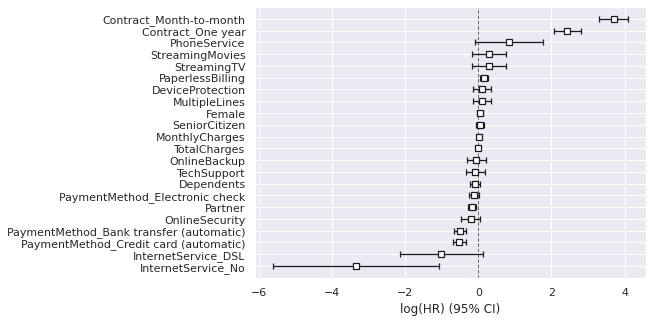

In [107]:
cph.plot()

In [108]:
cph.params_ # the estimated coefficients

covariate
SeniorCitizen                              0.034453
Partner                                   -0.177998
Dependents                                -0.091525
PhoneService                               0.828169
MultipleLines                              0.086928
OnlineSecurity                            -0.213291
OnlineBackup                              -0.055995
DeviceProtection                           0.087723
TechSupport                               -0.084330
StreamingTV                                0.281108
StreamingMovies                            0.286625
PaperlessBilling                           0.149824
MonthlyCharges                             0.013162
TotalCharges                              -0.001603
Female                                     0.039404
InternetService_DSL                       -1.017472
InternetService_No                        -3.356393
Contract_Month-to-month                    3.700998
Contract_One year                          2.434555
Pa

### we can plot what the survival curves look like as we vary a single covariate while holding everything else equal. This is useful to understand the impact of a covariate, given the model.

<AxesSubplot:>

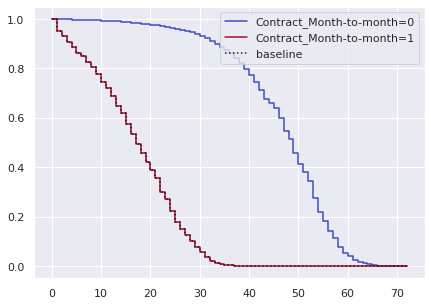

In [111]:
cph.plot_partial_effects_on_outcome('Contract_Month-to-month', [0, 1], cmap='coolwarm')

In [112]:
# predict expectation
cph.predict_expectation(data)

0       20.433055
1       44.854506
2       12.317133
3       56.734993
4        4.594059
          ...    
7038    39.605354
7039    71.825685
7040    26.577785
7041     5.354433
7042    71.966575
Length: 7043, dtype: float64

In [113]:
# predict Log partial Hazard

cph.predict_log_partial_hazard(data)

0       3.536191
1       0.516105
2       4.603133
3      -1.021369
4       5.958260
          ...   
7038    1.171405
7039   -6.421250
7040    2.776610
7041    5.785661
7042   -8.079302
Length: 7043, dtype: float64

In [114]:
# event observed variable provided 

cph.event_observed

488     False
753     False
936     False
1082    False
1340    False
        ...  
3439     True
3890     True
4513     True
4610     True
6424     True
Name: Churn, Length: 7043, dtype: bool

In [115]:
cph.baseline_cumulative_hazard_

,baseline cumulative hazard
0.0,0.000000
1.0,0.000868
2.0,0.001293
3.0,0.001703
4.0,0.002158
5.0,0.002588
6.0,0.002912
7.0,0.003388
8.0,0.003863
9.0,0.004475


<AxesSubplot:>

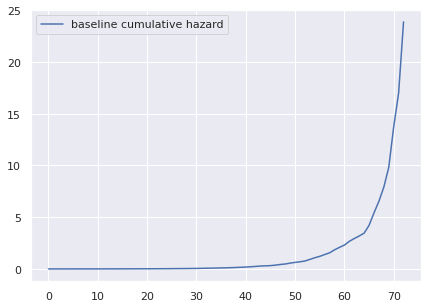

In [116]:
sns.lineplot(data=cph.baseline_cumulative_hazard_)

### Internet Service Vs. No Internet Service:

    InternetService_No = 1 : no internet service
    
    InternetService_No = 0 : internet service is available

<AxesSubplot:>

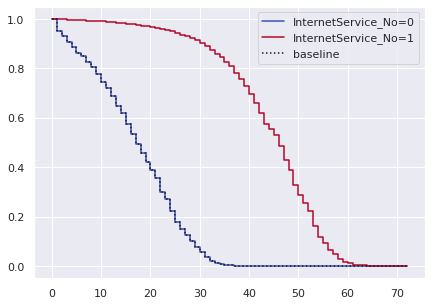

In [117]:
cph.plot_partial_effects_on_outcome('InternetService_No', [0, 1], cmap='coolwarm')

### Online Security Vs. No Online Security

<AxesSubplot:>

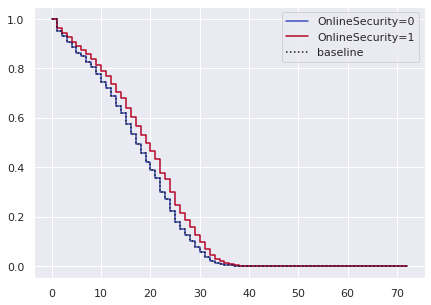

In [123]:
cph.plot_partial_effects_on_outcome('OnlineSecurity', [0,1], cmap='coolwarm')

### DSL Internet Service Vs. Other Internet Service ot No Internet Service 

<AxesSubplot:>

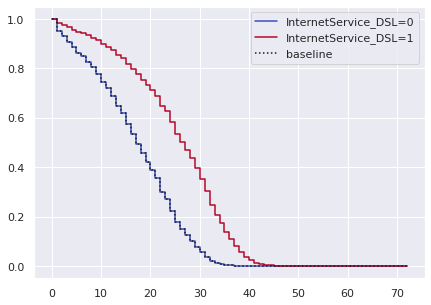

In [124]:
cph.plot_partial_effects_on_outcome('InternetService_DSL', [0,1], cmap='coolwarm')

### One Year Contract Vs. Two Year and Monthly Contract

<AxesSubplot:>

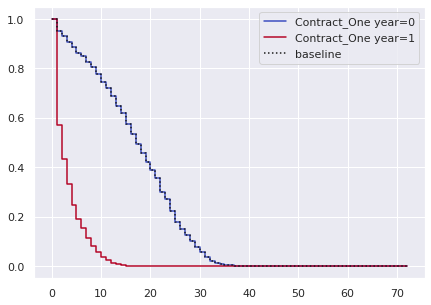

In [132]:
cph.plot_partial_effects_on_outcome('Contract_One year', [0,1], cmap='coolwarm')

### Phone Service Vs. No Phone Service

<AxesSubplot:>

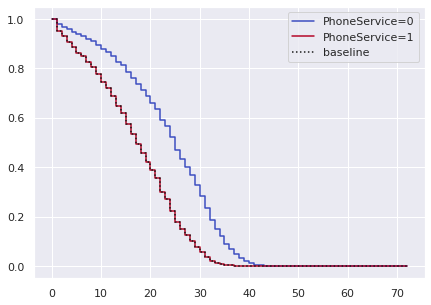

In [133]:
cph.plot_partial_effects_on_outcome('PhoneService', [0,1], cmap='coolwarm')

### Senior Citizens Vs. Normal Citizens

<AxesSubplot:>

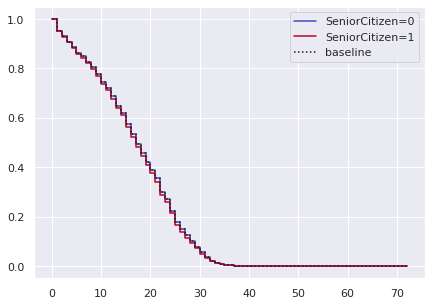

In [134]:
cph.plot_partial_effects_on_outcome('SeniorCitizen', [0,1], cmap='coolwarm')

### Dependents Vs. No Deendents

<AxesSubplot:>

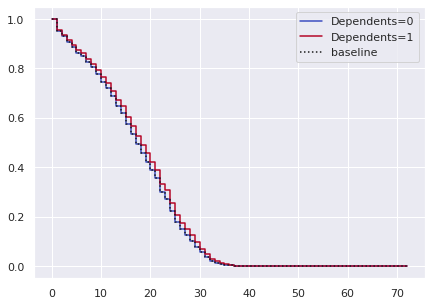

In [135]:
cph.plot_partial_effects_on_outcome('Dependents', [0,1], cmap='coolwarm')

### Senior Citizen and Partner

Text(0.5, 1.0, 'Senior Citizens with Patner')

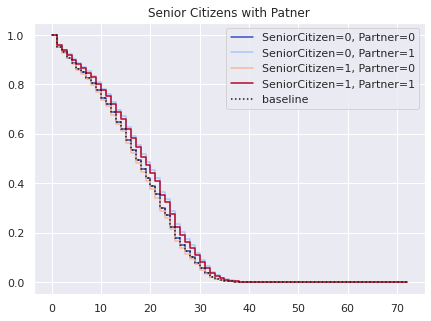

In [139]:
cph.plot_partial_effects_on_outcome(['SeniorCitizen', 'Partner'], [
    [0, 0],
    [0, 1],
    [1, 0],
    [1, 1],
], cmap='coolwarm')
plt.title("Senior Citizens with Patner")

In [ ]:
### Senior Citizen with Dependents

Text(0.5, 1.0, 'Senior Citizens with Dependents')

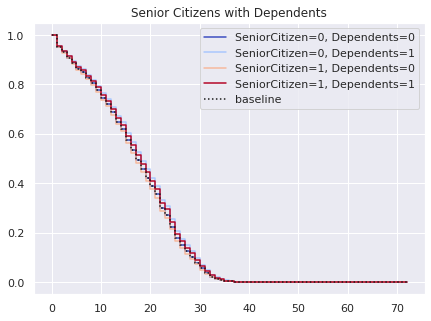

In [141]:
cph.plot_partial_effects_on_outcome(['SeniorCitizen', 'Dependents'], [
    [0, 0],
    [0, 1],
    [1, 0],
    [1, 1],
], cmap='coolwarm')
plt.title("Senior Citizens with Dependents")

### Phone Service and Internet Service

Text(0.5, 1.0, '### Phone Service and Internet Service')

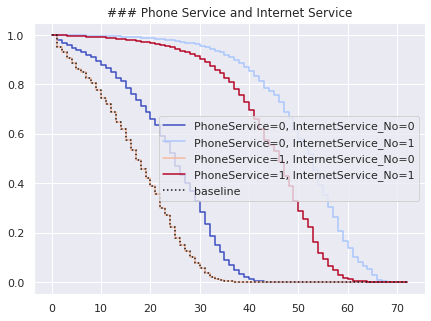

In [142]:
cph.plot_partial_effects_on_outcome(['PhoneService', 'InternetService_No'], [
    [0, 0],
    [0, 1],
    [1, 0],
    [1, 1],
], cmap='coolwarm')
plt.title("### Phone Service and Internet Service")

## Predicting Survival of all customers

In [143]:
data['ID'] = df['customerID']
data.head()

,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,Female,InternetService_DSL,InternetService_No,Contract_Month-to-month,Contract_One year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,ID
0,0,1,0,1,0,0,0,1,0,0,0,0,1,29.85,29.85,0,1,1,0,1,0,0,0,1,7590-VHVEG
1,0,0,0,34,1,0,1,0,1,0,0,0,0,56.95,1889.50,0,0,1,0,0,1,0,0,0,5575-GNVDE
2,0,0,0,2,1,0,1,1,0,0,0,0,1,53.85,108.15,1,0,1,0,1,0,0,0,0,3668-QPYBK
3,0,0,0,45,0,0,1,0,1,1,0,0,0,42.30,1840.75,0,0,1,0,0,1,1,0,0,7795-CFOCW
4,0,0,0,2,1,0,0,0,0,0,0,0,1,70.70,151.65,1,1,0,0,1,0,0,0,1,9237-HQITU


In [144]:
cph.predict_survival_function(data.drop('ID', axis=1))

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,...,6793,6794,6795,6796,6797,6798,6799,6800,6801,6802,6803,6804,6805,6806,6807,6808,6809,6810,6811,6812,6813,6814,6815,6816,6817,6818,6819,6820,6821,6822,6823,6824,6825,6826,6827,6828,6829,6830,6831,6832,6833,6834,6835,6836,6837,6838,6839,6840,6841,6842,6843,6844,6845,6846,6847,6848,6849,6850,6851,6852,6853,6854,6855,6856,6857,6858,6859,6860,6861,6862,6863,6864,6865,6866,6867,6868,6869,6870,6871,6872,6873,6874,6875,6876,6877,6878,6879,6880,6881,6882,6883,6884,6885,6886,6887,6888,6889,6890,6891,6892,6893,6894,6895,6896,6897,6898,6899,6900,6901,6902,6903,6904,6905,6906,6907,6908,6909,6910,6911,6912,6913,6914,6915,6916,6917,6918,6919,6920,6921,6922,6923,6924,6925,6926,6927,6928,6929,6930,6931,6932,6933,6934,6935,6936,6937,6938,6939,6940,6941,6942,6943,6944,6945,6946,6947,6948,6949,6950,6951,6952,6953,6954,6955,6956,6957,6958,6959,6960,6961,6962,6963,6964,6965,6966,6967,6968,6969,6970,6971,6972,6973,6974,6975,6976,6977,6978,6979,6980,6981,6982,6983,6984,6985,6986,6987,6988,6989,6990,6991,6992,6993,6994,6995,6996,6997,6998,6999,7000,7001,7002,7003,7004,7005,7006,7007,7008,7009,7010,7011,7012,7013,7014,7015,7016,7017,7018,7019,7020,7021,7022,7023,7024,7025,7026,7027,7028,7029,7030,7031,7032,7033,7034,7035,7036,7037,7038,7039,7040,7041,7042
0.0,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000,1.000000,1.000000e+00,1.000000,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000,1.000000,1.000000,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000,1.000000e+00,1.000000,1.000000,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,1.000000e+00,1.000000e+00,1.00

In [145]:
cph.predict_median(data.drop('ID', axis=1))

0       22.0
1       47.0
2       13.0
3       59.0
4        4.0
        ... 
7038    42.0
7039     inf
7040    29.0
7041     4.0
7042     inf
Name: 0.5, Length: 7043, dtype: float64

In [146]:
cph.predict_partial_hazard(data.drop('ID', axis=1))

0        34.335899
1         1.675488
2        99.796493
3         0.360101
4       386.936421
           ...    
7038      3.226524
7039      0.001627
7040     16.064462
7041    325.597196
7042      0.000310
Length: 7043, dtype: float64

In [147]:
cph.predict_median(data)

0       22.0
1       47.0
2       13.0
3       59.0
4        4.0
        ... 
7038    42.0
7039     inf
7040    29.0
7041     4.0
7042     inf
Name: 0.5, Length: 7043, dtype: float64

## Predicing survival of a specific customer

In [149]:
customer_id = '3668-QPYBK'
input_ = data.loc[data['ID'] == customer_id]
input_.head()

,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,Female,InternetService_DSL,InternetService_No,Contract_Month-to-month,Contract_One year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,ID
2,0,0,0,2,1,0,1,1,0,0,0,0,1,53.85,108.15,1,0,1,0,1,0,0,0,0,3668-QPYBK


In [150]:
# validate
print('Total number of customer with ' + customer_id + ' is : ' + str(data.loc[data['ID'] == customer_id].shape[0]))

Total number of customer with 3668-QPYBK is : 1


In [151]:
# Get index of the customer
customer = data[data['ID'] == customer_id].index

# deleting the row containing information about that customer
data.drop(customer, inplace=True)

# validate
print('Total number of customer with ' + customer_id + ' is : ' + str(data.loc[data['ID'] == customer_id].shape[0]))

Total number of customer with 3668-QPYBK is : 0


In [152]:
data.drop('ID', axis=1, inplace=True)
data.head()

,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,Female,InternetService_DSL,InternetService_No,Contract_Month-to-month,Contract_One year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check
0,0,1,0,1,0,0,0,1,0,0,0,0,1,29.85,29.85,0,1,1,0,1,0,0,0,1
1,0,0,0,34,1,0,1,0,1,0,0,0,0,56.95,1889.50,0,0,1,0,0,1,0,0,0
3,0,0,0,45,0,0,1,0,1,1,0,0,0,42.30,1840.75,0,0,1,0,0,1,1,0,0
4,0,0,0,2,1,0,0,0,0,0,0,0,1,70.70,151.65,1,1,0,0,1,0,0,0,1
5,0,0,0,8,1,1,0,0,1,0,1,1,1,99.65,820.50,1,1,0,0,1,0,0,0,1


In [154]:
cph = CoxPHFitter()
cph.fit(data, 'tenure', event_col='Churn', show_progress=True)

Iteration 1: norm_delta = 2.43470, step_size = 0.9000, log_lik = -15644.21706, newton_decrement = 2319.50498, seconds_since_start = 0.0
Iteration 2: norm_delta = 1.74874, step_size = 0.9000, log_lik = -13364.51442, newton_decrement = 474.00114, seconds_since_start = 0.0
Iteration 3: norm_delta = 1.19541, step_size = 0.9000, log_lik = -12830.82343, newton_decrement = 137.39895, seconds_since_start = 0.0
Iteration 4: norm_delta = 0.53545, step_size = 1.0000, log_lik = -12669.02996, newton_decrement = 15.84989, seconds_since_start = 0.1
Iteration 5: norm_delta = 0.08516, step_size = 1.0000, log_lik = -12651.96727, newton_decrement = 0.29333, seconds_since_start = 0.1
Iteration 6: norm_delta = 0.00259, step_size = 1.0000, log_lik = -12651.66869, newton_decrement = 0.00025, seconds_since_start = 0.1
Iteration 7: norm_delta = 0.00000, step_size = 1.0000, log_lik = -12651.66844, newton_decrement = 0.00000, seconds_since_start = 0.1
Convergence success after 7 iterations.


<lifelines.CoxPHFitter: fitted with 7042 total observations, 5174 right-censored observations>

Text(0.5, 1.0, 'Survival of the Customer: 3668-QPYBK')

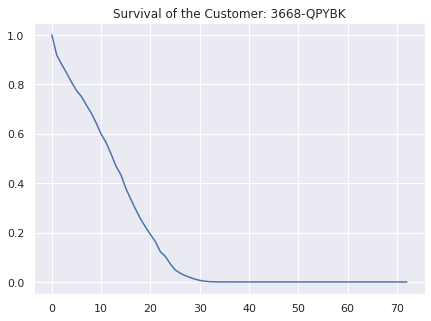

In [157]:
results = cph.predict_survival_function(input_.drop('ID', axis=1))
sns.lineplot(data=results, legend=False).set_title('Survival of the Customer: ' + str(customer_id))

In [158]:
cph.predict_partial_hazard(input_.drop('ID', axis=1))

2    98.844059
dtype: float64

## Using Cross Validation

In [161]:
from lifelines.utils import k_fold_cross_validation

cph = CoxPHFitter()

print(np.mean(k_fold_cross_validation(cph, data, duration_col='tenure', event_col='Churn')))

-1.374653190990411
